<a href="https://colab.research.google.com/github/marcoa08/phyton-scripts/blob/main/simulacion_movimiento_browninano.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 516.3/516.3 kB 8.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 21.0 MB/s eta 0:00:00


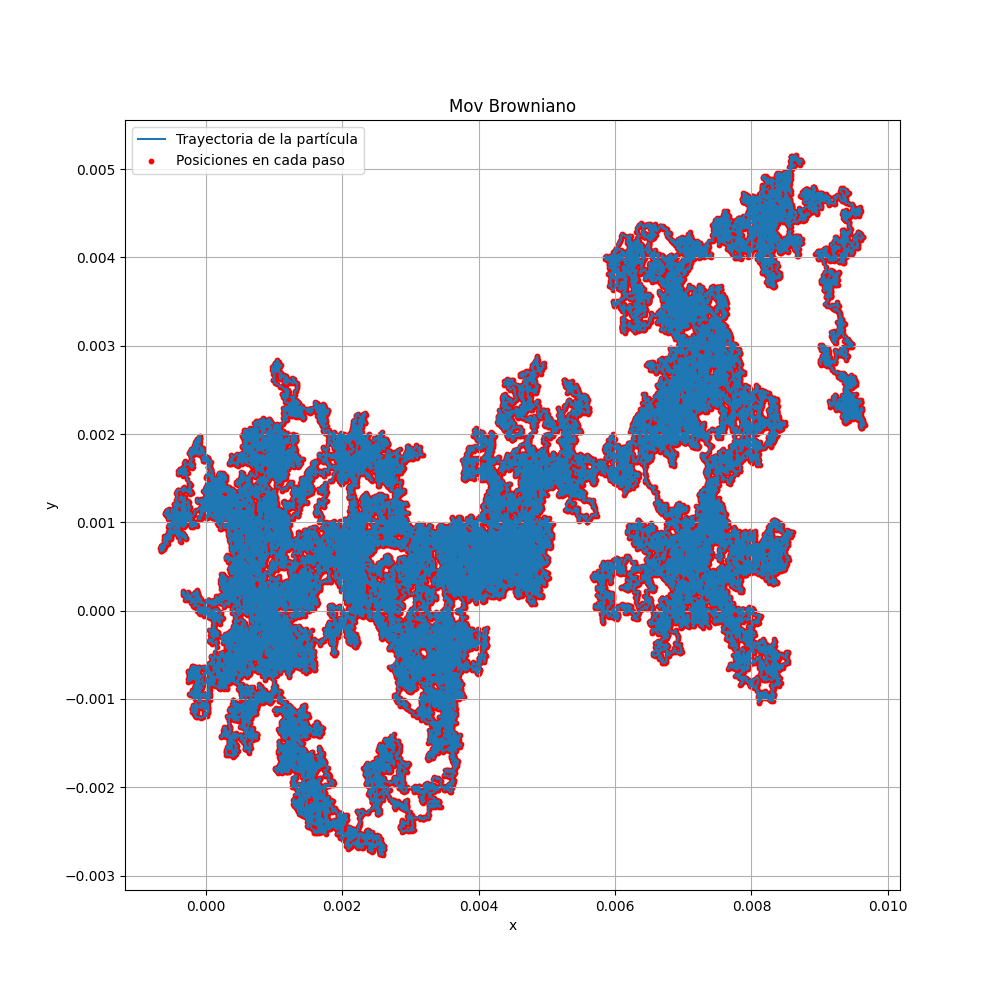

<ipython-input-1-a79504a6aa96>:92: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  point.set_data(x[i], y[i])


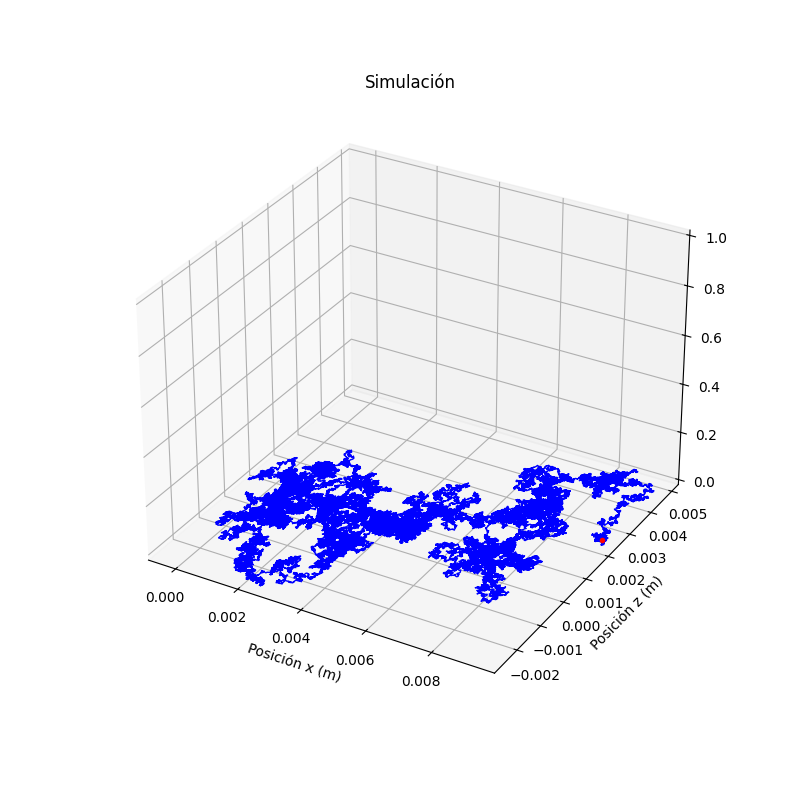

In [ ]:
!pip install ipympl
import numpy as np
import math
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import matplotlib
matplotlib.use('module://ipympl.backend_nbagg')
from mpl_toolkits.mplot3d import Axes3D  # Import for 3D plotting

from mpl_toolkits.mplot3d import Axes3D  # Import for 3D plotting

#animacion
#ani_html = ani.to_html5_video()
# Generate the HTML representation of the animation
#ani_html = ani.to_html5_video()  # This line was previously commented out

# Display the animation in the notebook
#HTML(ani_html)

# Parámetros de la simulación
m = 1e-12           # Masa de la partícula
eta = 0.001           # Viscosidad
a = 1.0e-9            # Radio de la partícula
kB = 1.380649e-23     # Constante de Boltzmann en J/K
T = 300              # Temperatura en Kelvin
dt = 1           # Paso de tiempo en segundos
num_steps =  100000 # Número de pasos de la simulación (reducción para pruebas)

# Coeficiente de Difusión
D = (kB * T) / (6 * math.pi * eta * a)
# gamma
E = 6 * math.pi * eta * a
# Inicialización de las posiciones
x = np.zeros(num_steps)
y = np.zeros(num_steps)
z = np.zeros(num_steps)

# Simulación del movimiento browniano
for i in range(3, num_steps):
    noise_x = np.random.normal(0, 1)
    noise_y = np.random.normal(0, 1)
    noise_z = np.random.normal(0, 1)
    x[i] = ((2+ dt*(E/m))/(1 + dt*(E/m)))*x[i-1] - (1/(1 +dt*(E/m)))* x[i-2] + np.sqrt(2*kB*T*E)/(m*(1 +dt*(E/m)))*(dt)**(3/2) * noise_x
    y[i] = ((2+ dt*(E/m)))/(1 + dt*(E/m))*y[i-1] - (1/(1 +dt*(E/m)))* y[i-2] + np.sqrt(2*kB*T*E)/(m*(1 +dt*(E/m)))*(dt)**(3/2) * noise_y
    z[i] = ((2+ dt*(E/m))/(1 + dt*(E/m)))*z[i-1] - (1/(1 +dt*(E/m)))* z[i-2] + np.sqrt(2*kB*T*E)/(m*(1 +dt*(E/m)))*(dt)**(3/2) * noise_x

    #x[i] = x[i-1] + np.sqrt(2 * D * dt) * noise_x
    #y[i] = y[i-1] + np.sqrt(2 * D * dt) * noise_y
    #z[i] = z[i-1] + np.sqrt(2 * D * dt) * noise_z



plt.figure(figsize=(10,10))
plt.plot(x, y, label='Trayectoria de la partícula')
plt.scatter(x, y, color='red', s=10, label='Posiciones en cada paso')
plt.title('Mov Browniano')
plt.xlabel('x')
plt.ylabel('y')

plt.legend()
plt.grid(True)
plt.show()

# Configuración de la animación
fig = plt.figure(figsize=(8, 8))
ax = fig.add_subplot(111, projection='3d')
ax.set_xlim(np.min(x), np.max(x) )
ax.set_ylim(np.min(y) , np.max(y) )
ax.set_xlabel('Posición x (m)')
ax.set_ylabel('Posición y (m)')
ax.set_ylabel('Posición z (m)')
ax.set_title('Simulación')

line, = ax.plot([], [],[] ,'b-', lw=1)
point, = ax.plot([], [],[] ,'ro', markersize=3)


ax.grid(True)

line, = ax.plot([], [], 'b-', lw=1)
point, = ax.plot([], [], 'ro', markersize=3)

def init():
    line.set_data([], [])
    point.set_data([], [])
    return line, point

def animate(i):
    line.set_data(x[:i], y[:i])
    line.set_3d_properties(z[:i])  # Update z data for the line
    point.set_data(x[i], y[i])
    point.set_3d_properties(z[i])
    point.set_data([x[i]], [y[i]])
    return line, point

# Ajuste de la velocidad de reproducción
ani = animation.FuncAnimation(fig, animate, init_func=init, frames=num_steps, interval=20, blit=True)
from IPython.display import HTML
HTML(ani.to_jshtml())
